# 1- Pre-proccess

### First unzip the files

In [ ]:
!unzip 'ZIP files/Phone YOLO.zip' -d 'Datasets/Phone_Detection'
!unzip 'ZIP files/Smoking YOLOv8 v1.zip' -d 'Datasets/Smoking_Detection'
!unzip 'ZIP files/Sleeping.zip' -d 'Datasets/Sleeping_Detection'
!unzip 'ZIP files/Mine-2.zip' -d 'Datasets/Drinking_Detection'

Archive:  /Users/khaledzsa/Desktop/Med_project/ZIP files/Phone YOLO.zip
 extracting: /Users/khaledzsa/Desktop/Med_project/Datasets/Phone_Detection/README.dataset.txt  
 extracting: /Users/khaledzsa/Desktop/Med_project/Datasets/Phone_Detection/README.roboflow.txt  
 extracting: /Users/khaledzsa/Desktop/Med_project/Datasets/Phone_Detection/data.yaml  
   creating: /Users/khaledzsa/Desktop/Med_project/Datasets/Phone_Detection/train/
   creating: /Users/khaledzsa/Desktop/Med_project/Datasets/Phone_Detection/train/images/
 extracting: /Users/khaledzsa/Desktop/Med_project/Datasets/Phone_Detection/train/images/-1-_jpeg_jpg.rf.09fb15a2ce473ad2b52c4665b4a5b258.jpg  
 extracting: /Users/khaledzsa/Desktop/Med_project/Datasets/Phone_Detection/train/images/-1-_jpeg_jpg.rf.0b903222c7cb220d3efdebde7e2df2ed.jpg  
 extracting: /Users/khaledzsa/Desktop/Med_project/Datasets/Phone_Detection/train/images/-1-_jpeg_jpg.rf.20a2f36bb57820f2182744660a6c631e.jpg  
 extracting: /Users/khaledzsa/Desktop/Med_projec

### Change class ID in each file

#### This method will change the class ID in each lable folder

In [ ]:
import os

def update_class_labels(class_id_old, class_id_new, path_to_folder):
    for filename in os.listdir(path_to_folder):
        if filename.endswith('.txt'):
            filepath = os.path.join(path_to_folder, filename)
            with open(filepath, 'r') as file:
                lines = file.readlines()
            with open(filepath, 'w') as file:
                for line in lines:
                    parts = line.split()
                    if parts[0] == str(class_id_old):
                        parts[0] = str(class_id_new)
                    file.write(' '.join(parts) + '\n')

##### Phone

In [ ]:
phone_train = 'Datasets/Phone_Detection/train/labels'
phone_valid = 'Datasets/Phone_Detection/valid/labels'

update_class_labels(0, 4, phone_train)
update_class_labels(0, 4, phone_valid)

##### Smoke

In [ ]:
smoke_train = 'Datasets/Smoking_Detection/train/labels'
smoke_valid = 'Datasets/Smoking_Detection/valid/labels'

update_class_labels(0, 5, smoke_train)
update_class_labels(0, 5, smoke_valid)

##### Drink

In [ ]:
drink_train = 'Datasets/Drinking_Detection/train/labels'
drink_valid = 'Datasets/Drinking_Detection/valid/labels'

update_class_labels(0, 6, drink_train)
update_class_labels(0, 6, drink_valid)

### Merge folders

In [ ]:

import os
import shutil

def copy_folder_contents(old_path, new_path):
    try:
        if not os.path.exists(new_path):
            os.makedirs(new_path)

        for item in os.listdir(old_path):

            old_item_path = os.path.join(old_path, item)

            new_item_path = os.path.join(new_path, item)

            if os.path.isfile(old_item_path):
                shutil.copy2(old_item_path, new_item_path)

            elif os.path.isdir(old_item_path):
                copy_folder_contents(old_item_path, new_item_path)

        print(f"Contents of '{old_path}' copied to '{new_path}' successfully.")
    except Exception as e:
        print(f"An error occurred: {e}")

In [ ]:
train_merged_img = 'Merged/train/images'
train_merged_labels = 'Merged/train/labels'
valid_merged_img = 'Merged/valid/images'
valid_merged_labels = 'Merged/valid/labels'

# Create the directory
if not os.path.exists(train_merged_img):
    os.makedirs(train_merged_img)
if not os.path.exists(train_merged_labels):
    os.makedirs(train_merged_labels)
if not os.path.exists(valid_merged_img):
    os.makedirs(valid_merged_img)
if not os.path.exists(valid_merged_labels):
    os.makedirs(valid_merged_labels)

##### Move eyes

In [ ]:
train_eyes_img = 'Datasets/Sleeping_Detection/train/images'
train_eyes_lables = 'Datasets/Sleeping_Detection/train/labels'
valid_eyes_img = 'Datasets/Sleeping_Detection/valid/images'
valid_eyes_lables = 'Datasets/Sleeping_Detection/train/labels'


copy_folder_contents(train_eyes_img, train_merged_img)
copy_folder_contents(train_eyes_lables, train_merged_labels)
copy_folder_contents(valid_eyes_img, valid_merged_img)
copy_folder_contents(valid_eyes_lables, valid_merged_labels)

Contents of '/Users/khaledzsa/Desktop/Med_project/Datasets/Sleeping_Detection/train/images' copied to '/Users/khaledzsa/Desktop/Med_project/Merged/train/images' successfully.
Contents of '/Users/khaledzsa/Desktop/Med_project/Datasets/Sleeping_Detection/train/labels' copied to '/Users/khaledzsa/Desktop/Med_project/Merged/train/labels' successfully.
Contents of '/Users/khaledzsa/Desktop/Med_project/Datasets/Sleeping_Detection/valid/images' copied to '/Users/khaledzsa/Desktop/Med_project/Merged/valid/images' successfully.
Contents of '/Users/khaledzsa/Desktop/Med_project/Datasets/Sleeping_Detection/train/labels' copied to '/Users/khaledzsa/Desktop/Med_project/Merged/valid/labels' successfully.


##### Move phone

In [ ]:
train_phone_img = 'Datasets/Phone_Detection/train/images'
train_phone_lables = 'Datasets/Phone_Detection/train/labels'
valid_phone_img = 'Datasets/Phone_Detection/valid/images'
valid_phone_lables = 'Datasets/Phone_Detection/train/labels'

copy_folder_contents(train_phone_img, train_merged_img)
copy_folder_contents(train_phone_lables, train_merged_labels)
copy_folder_contents(valid_phone_img, valid_merged_img)
copy_folder_contents(valid_phone_lables, valid_merged_labels)

Contents of '/Users/khaledzsa/Desktop/Med_project/Datasets/Phone_Detection/train/images' copied to '/Users/khaledzsa/Desktop/Med_project/Merged/train/images' successfully.
Contents of '/Users/khaledzsa/Desktop/Med_project/Datasets/Phone_Detection/train/labels' copied to '/Users/khaledzsa/Desktop/Med_project/Merged/train/labels' successfully.
Contents of '/Users/khaledzsa/Desktop/Med_project/Datasets/Phone_Detection/valid/images' copied to '/Users/khaledzsa/Desktop/Med_project/Merged/valid/images' successfully.
Contents of '/Users/khaledzsa/Desktop/Med_project/Datasets/Phone_Detection/train/labels' copied to '/Users/khaledzsa/Desktop/Med_project/Merged/valid/labels' successfully.


##### Move smoke

In [ ]:
train_smoke_img = 'Datasets/Smoking_Detection/train/images'
train_smoke_labels = 'Datasets/Smoking_Detection/train/labels'
valid_smoke_img = 'Datasets/Smoking_Detection/valid/images'
valid_smoke_labels = 'Datasets/Smoking_Detection/valid/labels'

copy_folder_contents(train_smoke_img, train_merged_img)
copy_folder_contents(train_smoke_labels, train_merged_labels)
copy_folder_contents(valid_smoke_img, valid_merged_img)
copy_folder_contents(valid_smoke_labels, valid_merged_labels)

Contents of '/Users/khaledzsa/Desktop/Med_project/Datasets/Smoking_Detection/train/images' copied to '/Users/khaledzsa/Desktop/Med_project/Merged/train/images' successfully.
Contents of '/Users/khaledzsa/Desktop/Med_project/Datasets/Smoking_Detection/train/labels' copied to '/Users/khaledzsa/Desktop/Med_project/Merged/train/labels' successfully.
Contents of '/Users/khaledzsa/Desktop/Med_project/Datasets/Smoking_Detection/valid/images' copied to '/Users/khaledzsa/Desktop/Med_project/Merged/valid/images' successfully.
Contents of '/Users/khaledzsa/Desktop/Med_project/Datasets/Smoking_Detection/valid/labels' copied to '/Users/khaledzsa/Desktop/Med_project/Merged/valid/labels' successfully.


##### Move drink

In [ ]:

train_drink_img = 'Datasets/Drinking_Detection/train/images'
train_drink_labels = 'Datasets/Drinking_Detection/train/labels'
valid_drink_img = 'Datasets/Drinking_Detection/valid/images'
valid_drink_labels = 'Datasets/Drinking_Detection/valid/labels'

copy_folder_contents(train_drink_img, train_merged_img)
copy_folder_contents(train_drink_labels, train_merged_labels)
copy_folder_contents(valid_drink_img, valid_merged_img)
copy_folder_contents(valid_drink_labels, valid_merged_labels)

Contents of '/Users/khaledzsa/Desktop/Med_project/Datasets/Drinking_Detection/train/images' copied to '/Users/khaledzsa/Desktop/Med_project/Merged/train/images' successfully.
Contents of '/Users/khaledzsa/Desktop/Med_project/Datasets/Drinking_Detection/train/labels' copied to '/Users/khaledzsa/Desktop/Med_project/Merged/train/labels' successfully.
Contents of '/Users/khaledzsa/Desktop/Med_project/Datasets/Drinking_Detection/valid/images' copied to '/Users/khaledzsa/Desktop/Med_project/Merged/valid/images' successfully.
Contents of '/Users/khaledzsa/Desktop/Med_project/Datasets/Drinking_Detection/valid/labels' copied to '/Users/khaledzsa/Desktop/Med_project/Merged/valid/labels' successfully.


In [ ]:
import os

def count_files_in_folder(folder_path):
    return len([name for name in os.listdir(folder_path) if os.path.isfile(os.path.join(folder_path, name))])

train_img_path = 'Merged/train/images'
count_files_in_folder(train_img_path)

44057

### Create the .yaml

In [ ]:
yaml_content = """
train: /content/Merged/train
val: /content/Merged/valid
nc: 7
names: ['closed', 'no_yawn', 'open', 'yawn', 'phone', 'smoking', 'drink']
"""

yaml_path = 'Merged/data.yaml'

with open(yaml_path, 'w') as yaml_file:
    yaml_file.write(yaml_content)

print(f"YAML file created at {yaml_path}")

YAML file created at /Users/khaledzsa/Desktop/Med_project/Merged/data.yaml


In [ ]:
!zip -r '/Users/khaledzsa/Desktop/Med_project/Merged_final_boss.zip' '/Users/khaledzsa/Desktop/Med_project/Merged'

  adding: Users/khaledzsa/Desktop/Med_project/Merged/ (stored 0%)
  adding: Users/khaledzsa/Desktop/Med_project/Merged/valid/ (stored 0%)
  adding: Users/khaledzsa/Desktop/Med_project/Merged/valid/images/ (stored 0%)
  adding: Users/khaledzsa/Desktop/Med_project/Merged/valid/images/img_78554_jpg.rf.b06bc17582594fcae124bcc572d78766.jpg (deflated 0%)
  adding: Users/khaledzsa/Desktop/Med_project/Merged/valid/images/yawn-324-_jpg.rf.3efbea975c4093db0fa9e7db6c5bdffa.jpg (deflated 2%)
  adding: Users/khaledzsa/Desktop/Med_project/Merged/valid/images/close-439-_PNG.rf.50be0852fb548da08c5a599adb0de50a.jpg (deflated 1%)
  adding: Users/khaledzsa/Desktop/Med_project/Merged/valid/images/yawn-61-_jpg.rf.8b3da5762693a12c6ec6b41591d60e86.jpg (deflated 2%)
  adding: Users/khaledzsa/Desktop/Med_project/Merged/valid/images/yawn-483-_jpg.rf.f6d7f404a187c2bcd58227d2be44f44e.jpg (deflated 3%)
  adding: Users/khaledzsa/Desktop/Med_project/Merged/valid/images/no_yawn-609-_jpg.rf.54be770868492a020095dfafe7a

###### There has been a slight changes on the classes, their ids and the size of the data.

# 2- Train the model (On google colab)

In [ ]:
import zipfile
import cv2
import matplotlib.pyplot as plt
import glob
import random
import os
from google.colab import drive
import shutil

In [ ]:
def plot_box(image, bboxes, labels):

    for bbox, label in zip(bboxes, labels):

        h, w, _ = image.shape
        x_center, y_center, bbox_width, bbox_height = bbox
        x_min = int((x_center - bbox_width / 2) * w)
        y_min = int((y_center - bbox_height / 2) * h)
        x_max = int((x_center + bbox_width / 2) * w)
        y_max = int((y_center + bbox_height / 2) * h)

        cv2.rectangle(image, (x_min, y_min), (x_max, y_max), (255, 0, 0), 2)

        cv2.putText(image, label, (x_min, y_min - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.9, (255,0,0), 2)
    return image

def plot(image_paths, label_paths, num_samples):
    all_images = []
    all_images.extend(glob.glob(image_paths+'/*.jpg'))
    all_images.extend(glob.glob(image_paths+'/*.JPG'))

    all_images.sort()

    num_images = len(all_images)

    plt.figure(figsize=(15, 12))
    for i in range(num_samples):
        j = random.randint(0, num_images-1)
        image_name = all_images[j]
        image_name = '.'.join(image_name.split(os.path.sep)[-1].split('.')[:-1])
        image = cv2.imread(all_images[j])
        with open(os.path.join(label_paths, image_name+'.txt'), 'r') as f:
            bboxes = []
            labels = []
            label_lines = f.readlines()
            for label_line in label_lines:
                try:
                    parts = label_line.strip().split()
                    label = parts[0]
                    bbox_values = parts[1:5]
                    if len(bbox_values) != 4:
                        continue
                    x_c, y_c, w, h = map(float, bbox_values)
                    bboxes.append([x_c, y_c, w, h])
                    labels.append(label)
                except ValueError:
                    print(f"Skipping line due to incorrect format: {label_line}")
                    continue
        result_image = plot_box(image, bboxes, labels)
        plt.subplot(2, 2, i+1)
        plt.imshow(result_image[:, :, ::-1])
        plt.axis('off')
    plt.subplots_adjust(wspace=1)
    plt.tight_layout()
    plt.show()


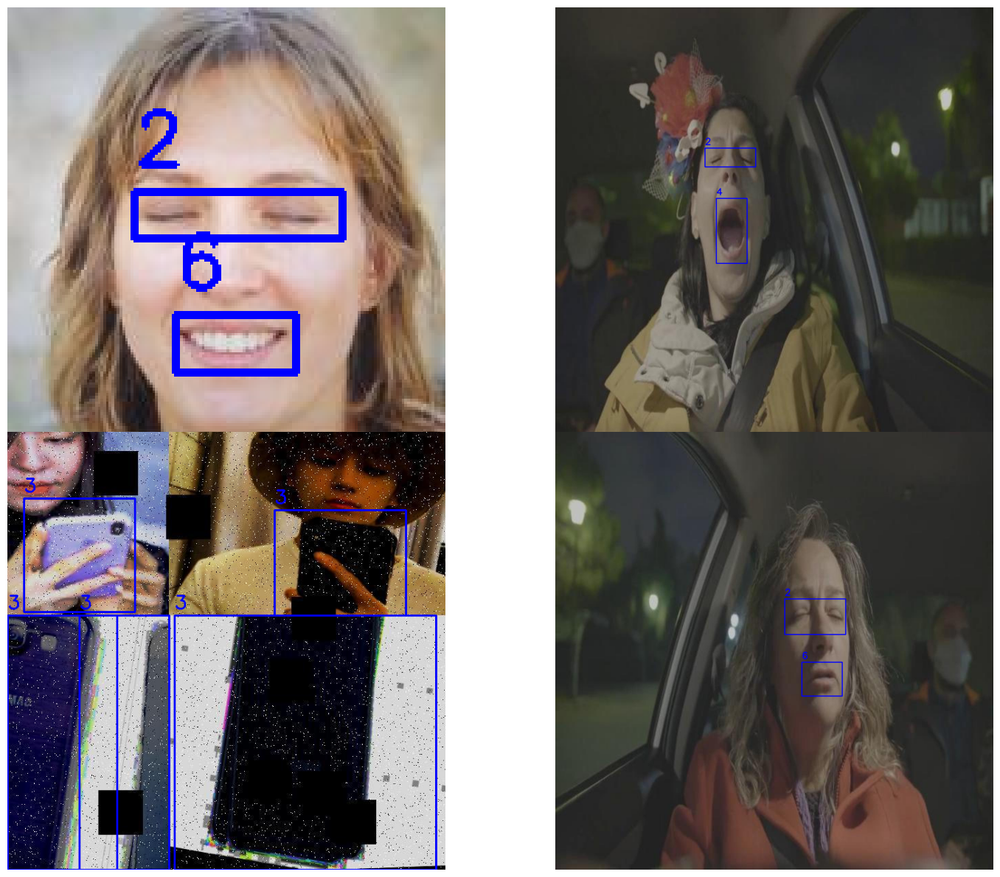

In [ ]:
plot(
    image_paths='/content/Merged/train/images/',
    label_paths='/content/Merged/train/labels/',
    num_samples=4
)

In [ ]:
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
zip_file_path = '/content/drive/MyDrive/THE_MODEL.zip'

extract_dir = '/content/'

os.makedirs(extract_dir, exist_ok=True)

with zipfile.ZipFile(zip_file_path, 'r') as zip_ref:
    zip_ref.extractall(extract_dir)

In [ ]:
!yolo task=detect mode=train model=yolov8l.pt data=/content/Merged/data.yaml epochs=20 batch=-1 imgsz=640 save_period=5  optimizer=auto

100% 83.7M/83.7M [00:00<00:00, 276MB/s]
New https://pypi.org/project/ultralytics/8.1.16 available 😃 Update with 'pip install -U ultralytics'
Ultralytics YOLOv8.0.196 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (NVIDIA A100-SXM4-40GB, 40514MiB)
engine/trainer: task=detect, mode=train, model=yolov8l.pt, data=/content/Merged/data.yaml, epochs=20, patience=50, batch=-1, imgsz=640, save=True, save_period=5, cache=False, device=None, workers=8, project=None, name=None, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, show=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, vid_stride=1, stream_buffer=False, l

In [ ]:
!zip -r /content/my_zip_file2.zip /content/runs

  adding: content/runs/ (stored 0%)
  adding: content/runs/detect/ (stored 0%)
  adding: content/runs/detect/train/ (stored 0%)
  adding: content/runs/detect/train/val_batch2_pred.jpg (deflated 7%)
  adding: content/runs/detect/train/val_batch1_pred.jpg (deflated 7%)
  adding: content/runs/detect/train/train_batch0.jpg (deflated 2%)
  adding: content/runs/detect/train/results.csv (deflated 83%)
  adding: content/runs/detect/train/PR_curve.png (deflated 8%)
  adding: content/runs/detect/train/events.out.tfevents.1708496902.9afd2db83eb0.7171.0 (deflated 79%)
  adding: content/runs/detect/train/train_batch4291.jpg (deflated 11%)
  adding: content/runs/detect/train/P_curve.png (deflated 7%)
  adding: content/runs/detect/train/F1_curve.png (deflated 6%)
  adding: content/runs/detect/train/labels.jpg (deflated 25%)
  adding: content/runs/detect/train/train_batch4290.jpg (deflated 9%)
  adding: content/runs/detect/train/weights/ (stored 0%)
  adding: content/runs/detect/train/weights/epoch15.

# 3- Run the model

##### Imports

In [14]:
import cv2
from ultralytics import YOLO
from tqdm.notebook import tqdm
from typing import List
import pygame
import math
import time
from supervision.draw.color import ColorPalette
from supervision.geometry.dataclasses import Point
from supervision.video.dataclasses import VideoInfo
from supervision.video.source import get_video_frames_generator
from supervision.video.sink import VideoSink
from supervision.notebook.utils import show_frame_in_notebook
from supervision.tools.detections import Detections, BoxAnnotator
from supervision.tools.line_counter import LineCounter, LineCounterAnnotator

##### Drawing methods

In [15]:

#customer rounded recatngels for better user interface
def draw_rounded_rect(img, top_left, bottom_right, color, thickness, corner_radius):
    cv2.rectangle(img,
                  (top_left[0] + corner_radius, top_left[1]),
                  (bottom_right[0] - corner_radius, bottom_right[1]),
                  color,
                  -1)  
    cv2.rectangle(img,
                  (top_left[0], top_left[1] + corner_radius),
                  (bottom_right[0], bottom_right[1] - corner_radius),
                  color,
                  -1)  

    
    cv2.circle(img, (top_left[0] + corner_radius, top_left[1] + corner_radius), corner_radius, color, -1)
    cv2.circle(img, (bottom_right[0] - corner_radius, top_left[1] + corner_radius), corner_radius, color, -1)
    cv2.circle(img, (top_left[0] + corner_radius, bottom_right[1] - corner_radius), corner_radius, color, -1)
    cv2.circle(img, (bottom_right[0] - corner_radius, bottom_right[1] - corner_radius), corner_radius, color, -1)


#unique color for each class
class_colors = {
    'Eyes closed': (255, 0, 0),  # Blue
    'Yawn': (255, 255, 0),  # Cyan
    'Phone': (0, 255, 255),  # Yellow
    'Cigarette': (255, 0, 255),  # Magenta
    'Drink': (255, 165, 0),  # Orange
}

##### Load the model

In [16]:
model = YOLO("content/runs/detect/train/weights/best.pt")

##### Code settings

In [17]:

#alarm sound for harmfull behavior
pygame.mixer.init()
detect_sound = pygame.mixer.Sound("alarm.mp3")

#used to track detected classes to enhance user interface
class_detected = {}
for i, name in enumerate(model.names):
    class_detected[model.names[i]] = False

#used to track time to show UI components then hide it
last_detected = {}
for i, name in enumerate(model.names):
    last_detected[model.names[i]] = 0


detection_made = False

#timer for messages
message_visible_until = 0

#timer for sound to prevent sound reduduncy
last_sound_played_at = 0

##### Applying computer vision using OpenCV & logic

In [21]:
cap = cv2.VideoCapture(0)
frame_width = int(cap.get(3))
frame_height = int(cap.get(4))
frame_fps = int(cap.get(5))

fourcc = cv2.VideoWriter_fourcc(*'mp4v')
output_path = '/Users/khaledzsa/Desktop/Med_project/Demo/output_video.mp4'
out = cv2.VideoWriter(output_path, fourcc, frame_fps, (frame_width, frame_height))

start_time = time.time()

while True:
    success, img = cap.read()

    current_time = time.time()

    #reset detected classes every iteration
    for i, name in enumerate(model.names):
        if class_detected[model.names[i]] and (current_time - last_detected[model.names[i]] > 3):
             class_detected[model.names[i]] = False

    
    detection_made = False

    results = model(img, stream=True)

    # Process detections
    for r in results:
        boxes = r.boxes

        for box in boxes:
            cls = int(box.cls[0])
            class_name = model.names[cls]
            
            if class_name in ['Eyes open', 'No yawn']:
                continue
            x1, y1, x2, y2 = box.xyxy[0]
            x1, y1, x2, y2 = int(x1), int(y1), int(x2), int(y2)

            cls = int(box.cls[0])
            cv2.rectangle(img, (x1, y1), (x2, y2), class_colors[model.names[cls]], 3)
            confidence = math.ceil((box.conf[0]*100))/100
            class_detected[model.names[cls]] = True
            last_detected[model.names[cls]] = time.time()
            org = [x1, y1]
            font = cv2.FONT_HERSHEY_SIMPLEX
            fontScale = 1
            color = class_colors[model.names[cls]]
            thickness = 2
            cv2.putText(img, model.names[cls], org, font, fontScale, class_colors[model.names[cls]], thickness)

    font = cv2.FONT_HERSHEY_SIMPLEX
    fontScale = 0.5
    color = (0, 255, 0)
    thickness = 2
    corner_radius = 5

    x_offset = 10  #for left top corner UI components
    y_offset = 10

    #creating UI boxes for each class to be showen when detected
    for i, name in enumerate(model.names):
        text = model.names[i]

        #these classes should not be showen
        if text == 'Eyes open' or text == 'No yawn':
            continue
        
        if class_detected[text]:
            color = class_colors[text]
        else:
            color = (128, 128, 128)
        text_size = cv2.getTextSize(text, font, fontScale, thickness)[0]
        text_width, text_height = text_size[0], text_size[1]
        baseline = cv2.getTextSize(text, font, fontScale, thickness)[1]

        #coordinates for the boxes
        rect_height = text_height + 20
        rect_top_left = (x_offset, y_offset + i * (rect_height + baseline) - 5)
        rect_bottom_right = (x_offset + text_width + 10, rect_top_left[1] + rect_height)

        draw_rounded_rect(img, rect_top_left, rect_bottom_right, color, -1, corner_radius)


        rect_center_y = rect_top_left[1] + rect_height // 2

        text_y = rect_center_y + (text_height // 2) - baseline // 2

        cv2.putText(img, text, (x_offset + 5, text_y), font, fontScale, (255, 255, 255), thickness)


    #splitting the classes to identfy the harmful behaviors
    harmful_detected = class_detected['Phone'] or (class_detected['Eyes closed'] and class_detected['Yawn'])
    caution_detected = class_detected['Yawn'] or class_detected['Cigarette'] or class_detected['Drink']

    if harmful_detected or caution_detected:
        detection_made = True
        message_visible_until = current_time + 3


    if current_time <= message_visible_until:

        if harmful_detected:
            message = "WARNING!  Hramfull action has been detected"
            square_color = (0, 0, 255)
            if current_time - last_sound_played_at >= 15:
                detect_sound.play()
                last_sound_played_at = current_time
        elif caution_detected:
            message = "Drive with caution"
            square_color = (0, 160, 255)

        # Drawing the message box
        frame_height, frame_width = img.shape[:2]
        text_size = cv2.getTextSize(message, font, fontScale, thickness)[0]
        text_width, text_height = text_size[0], text_size[1]

        
        square_width = text_width + 20
        square_height = text_height + 10
        top_left = ((frame_width - square_width) // 2, frame_height - square_height - 20)
        bottom_right = ((frame_width + square_width) // 2, frame_height - 10)

        
        draw_rounded_rect(img, top_left, bottom_right, square_color, -1, corner_radius)

        
        text_x = top_left[0] + (square_width - text_width) // 2
        text_y = top_left[1] + (square_height - text_height) // 2 + text_height

        
        cv2.putText(img, message, (text_x, text_y), font, fontScale, (255, 255, 255), thickness)

    else:
        pass

    
    out.write(img)
    if time.time() - start_time > 25:
        break
    if cv2.waitKey(1) == ord('q'):
        break
out.release()
cap.release()
cv2.destroyAllWindows()


0: 384x640 1 Cigarette, 1751.7ms
Speed: 72.4ms preprocess, 1751.7ms inference, 34.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 Cigarette, 903.7ms
Speed: 4.6ms preprocess, 903.7ms inference, 2.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 Cigarette, 510.1ms
Speed: 4.1ms preprocess, 510.1ms inference, 0.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 Cigarette, 383.1ms
Speed: 1.5ms preprocess, 383.1ms inference, 0.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 Cigarette, 303.3ms
Speed: 2.4ms preprocess, 303.3ms inference, 0.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 247.2ms
Speed: 1.0ms preprocess, 247.2ms inference, 0.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 243.5ms
Speed: 1.6ms preprocess, 243.5ms inference, 0.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 242.1ms
Speed: 1.0ms preprocess, 242.1ms i

: 

# 4- Metrics

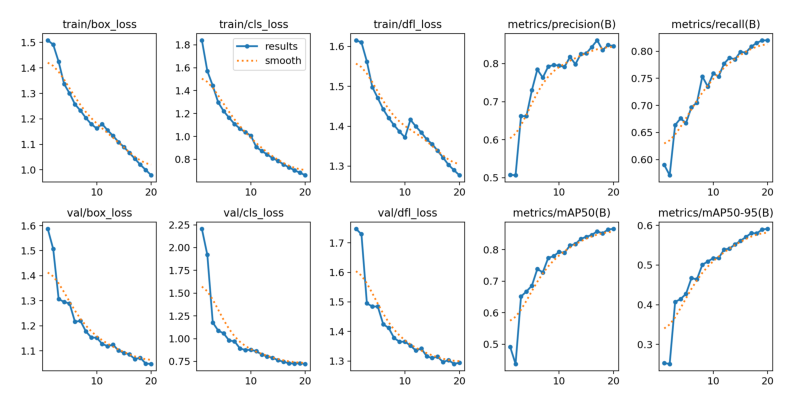

In [4]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

img = mpimg.imread('content/runs/detect/train/results.png')
plt.figure(figsize=(10, 10))
plt.imshow(img)
plt.axis('off')
plt.show()

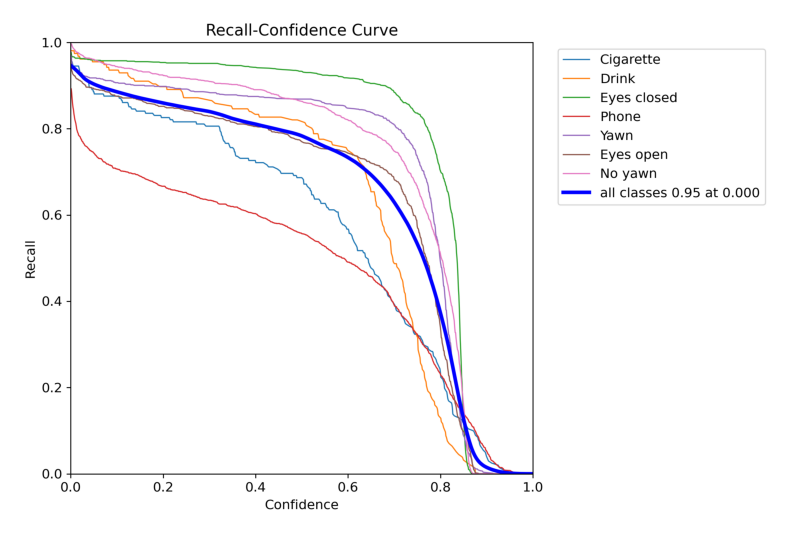

In [3]:
img = mpimg.imread('content/runs/detect/train/R_curve.png')
plt.figure(figsize=(10, 10))
plt.imshow(img)
plt.axis('off')
plt.show()

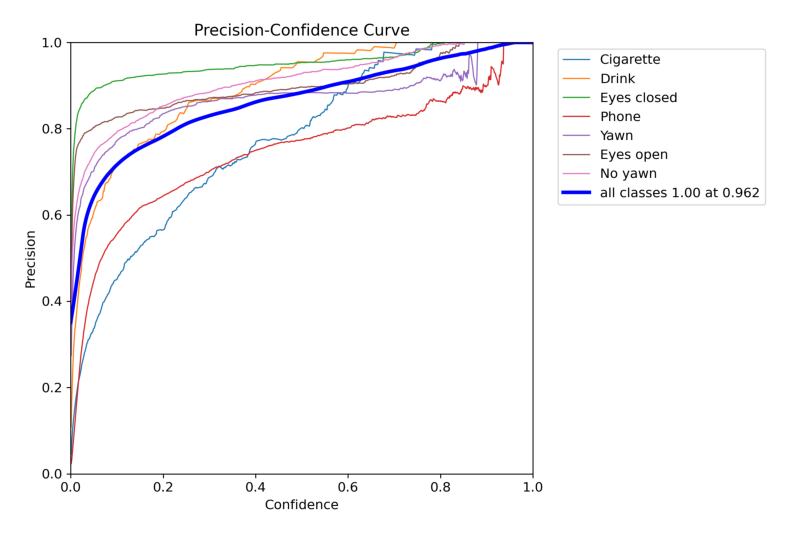

In [2]:
img = mpimg.imread('content/runs/detect/train/P_curve.png')
plt.figure(figsize=(10, 10))
plt.imshow(img)
plt.axis('off')
plt.show()

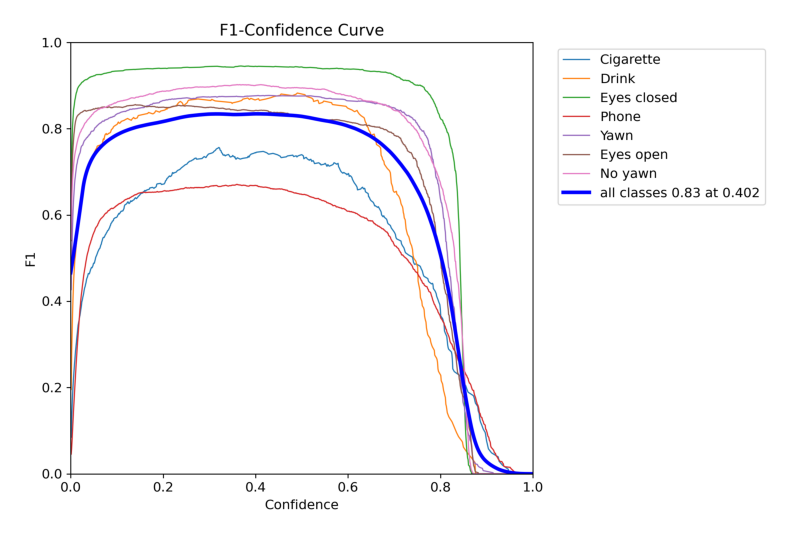

In [6]:
img = mpimg.imread('content/runs/detect/train/F1_curve.png')
plt.figure(figsize=(10, 10))
plt.imshow(img)
plt.axis('off')
plt.show()

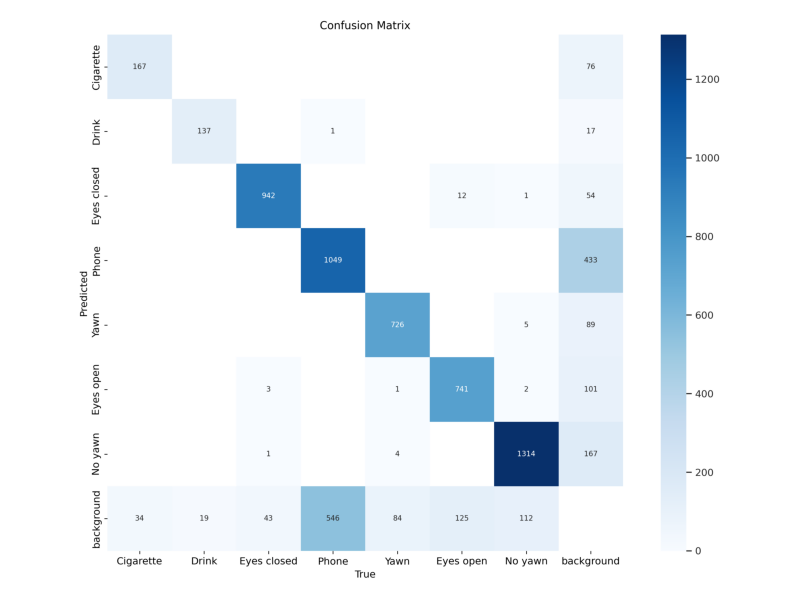

In [1]:
img = mpimg.imread('content/runs/detect/train/confusion_matrix.png')
plt.figure(figsize=(10, 10))
plt.imshow(img)
plt.axis('off')
plt.show()